In [4]:
import pandas as pd
import numpy as np
import matplotlib
from sklearn.preprocessing import LabelEncoder,StandardScaler,MinMaxScaler
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans,AgglomerativeClustering
import seaborn as sns
from sklearn.metrics import silhouette_score
from kneed import KneeLocator
from scipy.cluster.hierarchy import dendrogram as scipy_dendrogram, linkage
from scipy.cluster.hierarchy import dendrogram
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report
%matplotlib inline

In [5]:
csv_path="../Dataset/data.csv"
df=pd.read_csv(csv_path)

In [6]:
df.head()

,age,test_time,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,Jitter:DDP,Shimmer,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE,sex
0,72,5.6431,0.00662,0.000034,0.00401,0.00317,0.01204,0.02565,0.230,0.01438,0.01309,0.01662,0.04314,0.014290,21.640,0.41888,0.54842,0.16006,0
1,72,12.6660,0.00300,0.000017,0.00132,0.00150,0.00395,0.02024,0.179,0.00994,0.01072,0.01689,0.02982,0.011112,27.183,0.43493,0.56477,0.10810,0
2,72,19.6810,0.00481,0.000025,0.00205,0.00208,0.00616,0.01675,0.181,0.00734,0.00844,0.01458,0.02202,0.020220,23.047,0.46222,0.54405,0.21014,0
3,72,25.6470,0.00528,0.000027,0.00191,0.00264,0.00573,0.02309,0.327,0.01106,0.01265,0.01963,0.03317,0.027837,24.445,0.48730,0.57794,0.33277,0
4,72,33.6420,0.00335,0.000020,0.00093,0.00130,0.00278,0.01703,0.176,0.00679,0.00929,0.01819,0.02036,0.011625,26.126,0.47188,0.56122,0.19361,0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5875 entries, 0 to 5874
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   age            5875 non-null   int64  
 1   test_time      5875 non-null   float64
 2   Jitter(%)      5875 non-null   float64
 3   Jitter(Abs)    5875 non-null   float64
 4   Jitter:RAP     5875 non-null   float64
 5   Jitter:PPQ5    5875 non-null   float64
 6   Jitter:DDP     5875 non-null   float64
 7   Shimmer        5875 non-null   float64
 8   Shimmer(dB)    5875 non-null   float64
 9   Shimmer:APQ3   5875 non-null   float64
 10  Shimmer:APQ5   5875 non-null   float64
 11  Shimmer:APQ11  5875 non-null   float64
 12  Shimmer:DDA    5875 non-null   float64
 13  NHR            5875 non-null   float64
 14  HNR            5875 non-null   float64
 15  RPDE           5875 non-null   float64
 16  DFA            5875 non-null   float64
 17  PPE            5875 non-null   float64
 18  sex     

In [8]:
x=df.drop('sex',axis=1)

In [9]:
df_data=pd.DataFrame(StandardScaler().fit_transform(x),columns=x.columns)
df_data

,age,test_time,Jitter(%),Jitter(Abs),Jitter:RAP,Jitter:PPQ5,Jitter:DDP,Shimmer,Shimmer(dB),Shimmer:APQ3,Shimmer:APQ5,Shimmer:APQ11,Shimmer:DDA,NHR,HNR,RPDE,DFA,PPE
0,0.815695,-1.632090,0.082905,-0.284379,0.327453,-0.028637,0.328505,-0.324594,-0.351642,-0.209709,-0.423356,-0.543466,-0.209704,-0.298721,-0.009205,-1.214066,-1.478500,-0.650658
1,0.815695,-1.500676,-0.560793,-0.756869,-0.533746,-0.476212,-0.534825,-0.534016,-0.573156,-0.545158,-0.565592,-0.529955,-0.545153,-0.351965,1.282650,-1.055119,-1.247880,-1.218585
2,0.815695,-1.369410,-0.238944,-0.540080,-0.300038,-0.320767,-0.298983,-0.669115,-0.564469,-0.741592,-0.702426,-0.645545,-0.741587,-0.199370,0.318711,-0.784860,-1.540139,-0.103280
3,0.815695,-1.257773,-0.155370,-0.484493,-0.344859,-0.170682,-0.344871,-0.423692,0.069668,-0.460540,-0.449763,-0.392849,-0.460787,-0.071754,0.644530,-0.536487,-1.062115,1.237075
4,0.815695,-1.108169,-0.498557,-0.665151,-0.658604,-0.529814,-0.659682,-0.658276,-0.586186,-0.783145,-0.651413,-0.464905,-0.783392,-0.343370,1.036305,-0.689195,-1.297953,-0.283954
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5870,-0.431361,0.934231,-0.372307,-0.359422,-0.421694,-0.427970,-0.422773,-0.583565,-0.655681,-0.561024,-0.528983,-0.600010,-0.560767,-0.116990,0.160696,0.997028,-1.411923,-0.064697
5871,-0.431361,1.066152,-0.566128,-0.537300,-0.575365,-0.484252,-0.574309,-0.421369,-0.416793,-0.501338,-0.442561,-0.422372,-0.501081,-0.338311,0.281189,-0.153430,-1.242097,-1.020641
5872,-0.431361,1.196763,-0.473663,-0.537300,-0.469717,-0.377049,-0.469728,-0.350143,-0.290834,-0.260328,-0.335135,-0.435882,-0.260576,-0.241573,0.789028,-0.629379,-1.048856,-0.852755
5873,-0.431361,1.326064,-0.594579,-0.659592,-0.546552,-0.473532,-0.547630,-0.743051,-0.781639,-0.772568,-0.686822,-0.721104,-0.772815,-0.404372,0.639170,0.269141,-1.269038,-0.847618


c:\Users\Lenovo\OneDrive\Documents\Forty Soybean Cultivars from Subsequent Harvests\.venv\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\Lenovo\OneDrive\Documents\Forty Soybean Cultivars from Subsequent Harvests\.venv\lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
  File "C:\Users\Lenovo\AppData\Local\Programs\Python\Python310\lib\subprocess.py", line 503, in run
    with Popen(*popenargs, **kwargs) as process:
  File "C:\Users\Lenovo\AppData\Local\Programs\Python\Python310\lib\subprocess.py", line 971, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,

[Text(0.5, 0, 'Jumlah Cluster'),
 Text(0, 0.5, 'sse'),
 Text(0.5, 1.0, 'Elbow Metode')]

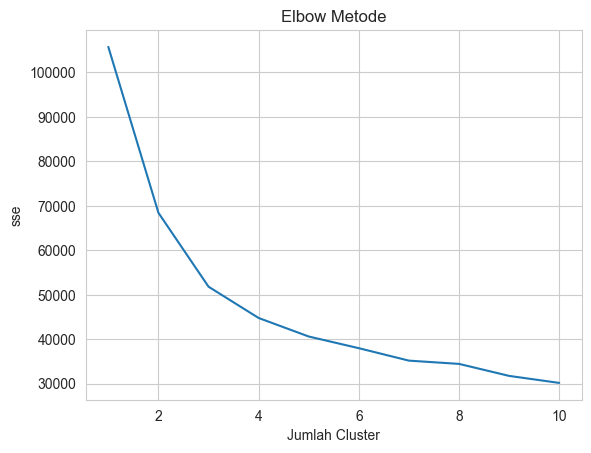

In [10]:
sse=[]
for k in range(1,11):
    km=KMeans(n_clusters=k,random_state=42)
    km.fit(df_data)
    sse.append(km.inertia_)
sns.set_style("whitegrid")
g=sns.lineplot(x=range(1,11),y=sse)
g.set(xlabel="Jumlah Cluster",
      ylabel="sse",
      title="Elbow Metode")

In [11]:
kn=KneeLocator(range(1,11),sse,curve='convex',direction='decreasing')
kn.elbow

3

In [12]:
df_data.columns

Index(['age', 'test_time', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP',
       'Jitter:PPQ5', 'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3',
       'Shimmer:APQ5', 'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE',
       'DFA', 'PPE'],
      dtype='object')

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_14656\2151028784.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))


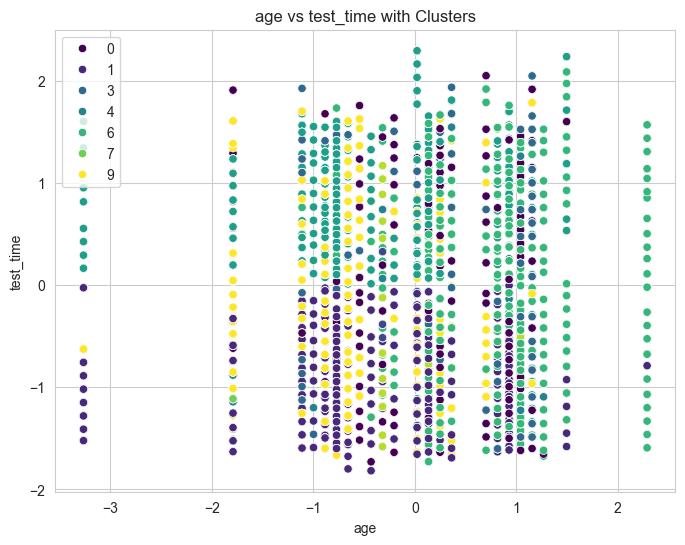

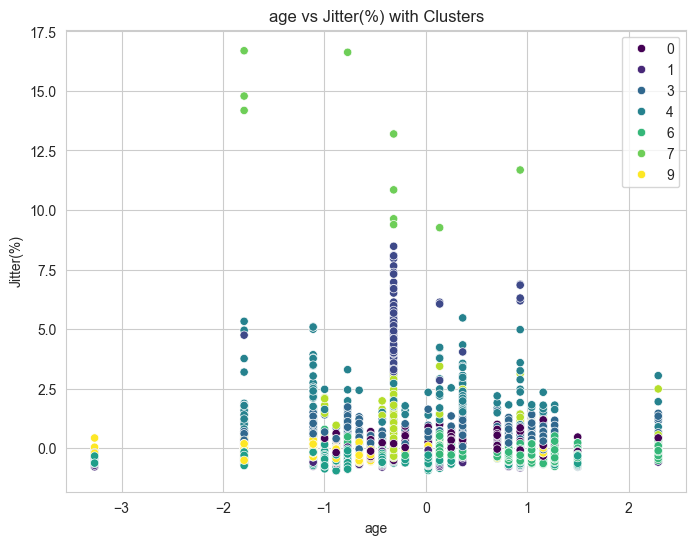

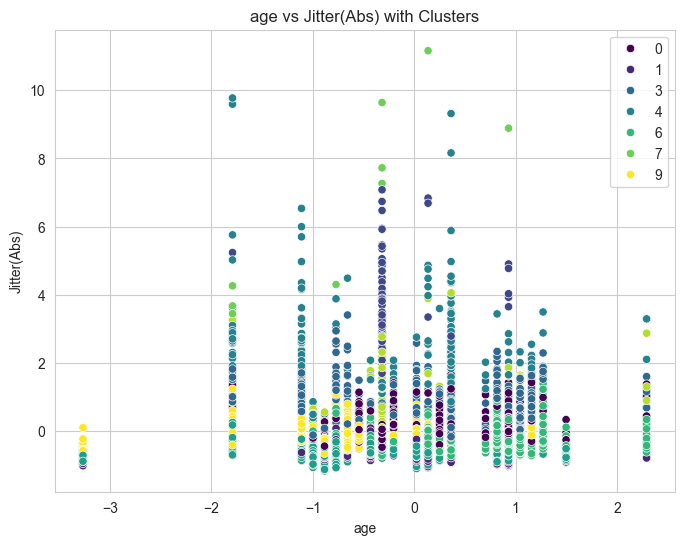

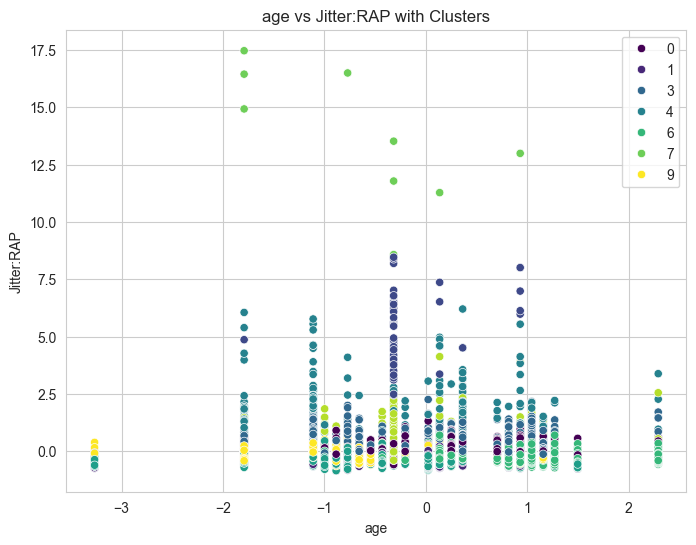

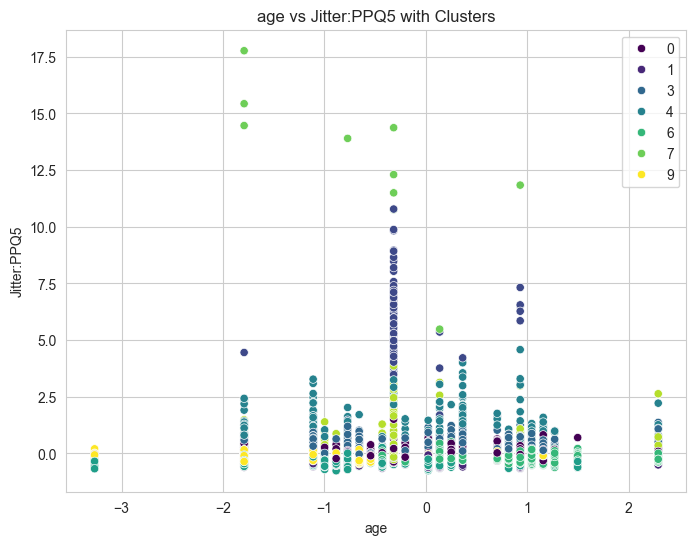

...

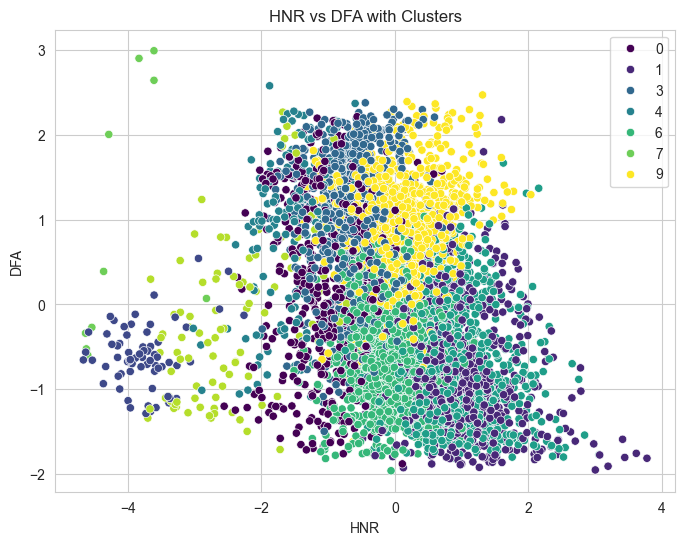

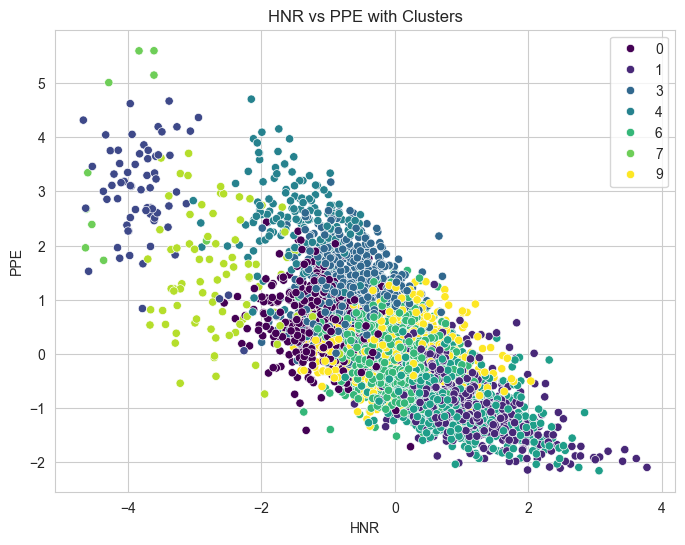

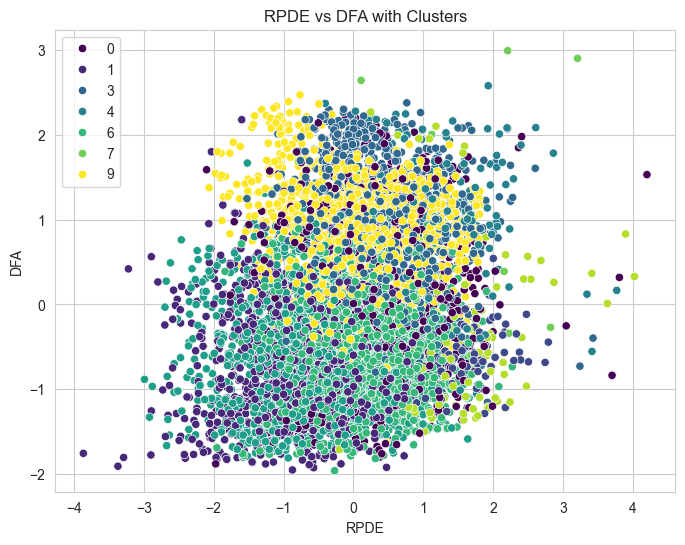

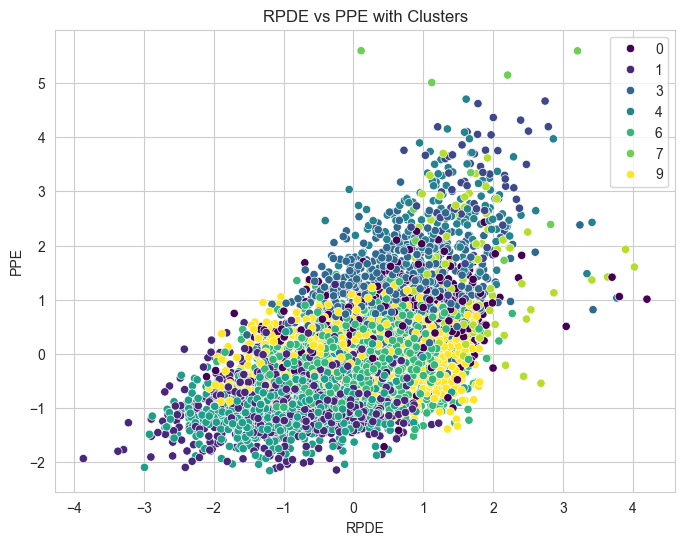

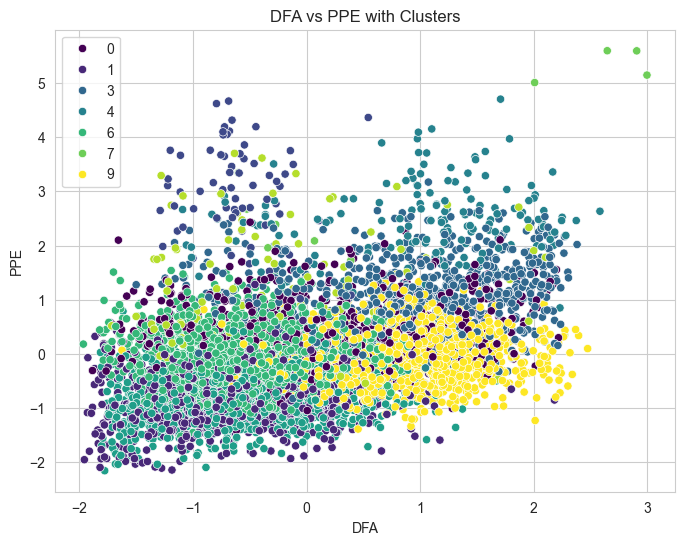

In [13]:
attributes = ['age', 'test_time', 'Jitter(%)', 'Jitter(Abs)', 'Jitter:RAP',
       'Jitter:PPQ5', 'Jitter:DDP', 'Shimmer', 'Shimmer(dB)', 'Shimmer:APQ3',
       'Shimmer:APQ5', 'Shimmer:APQ11', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE',
       'DFA', 'PPE']

for i in range(len(attributes)):
    for j in range(i + 1, len(attributes)):
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=df_data, x=attributes[i], y=attributes[j], hue=km.labels_, palette='viridis')
        plt.xlabel(attributes[i])
        plt.ylabel(attributes[j])
        plt.title(f'{attributes[i]} vs {attributes[j]} with Clusters')
        plt.legend()

In [14]:
data_new=pd.DataFrame(df)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


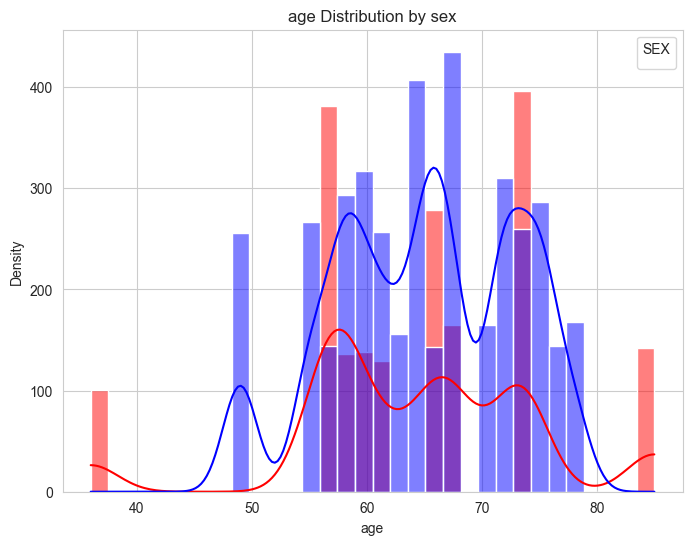

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


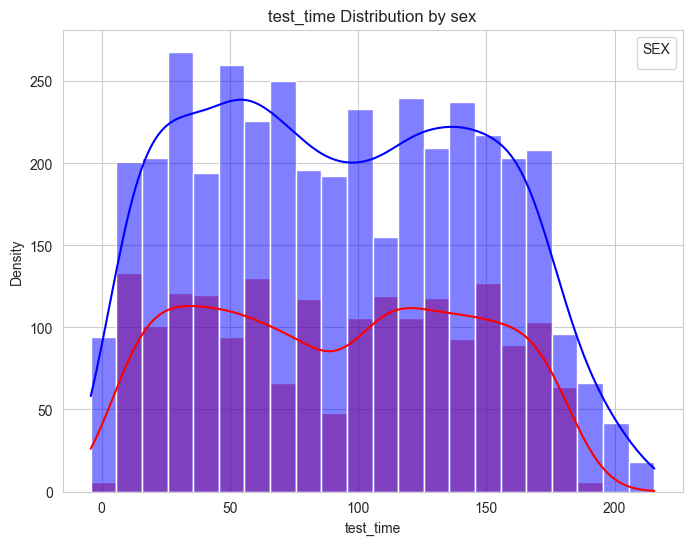

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


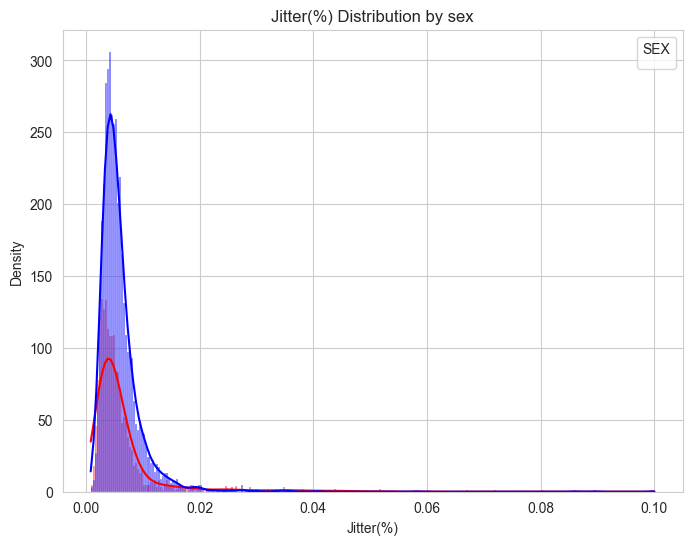

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


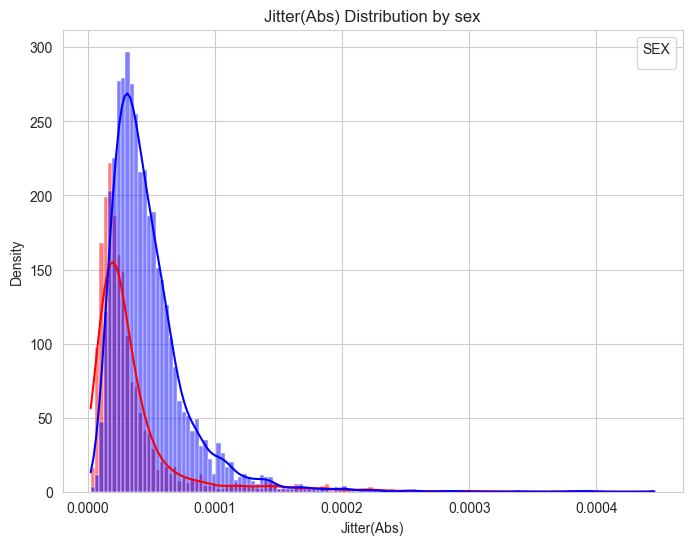

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


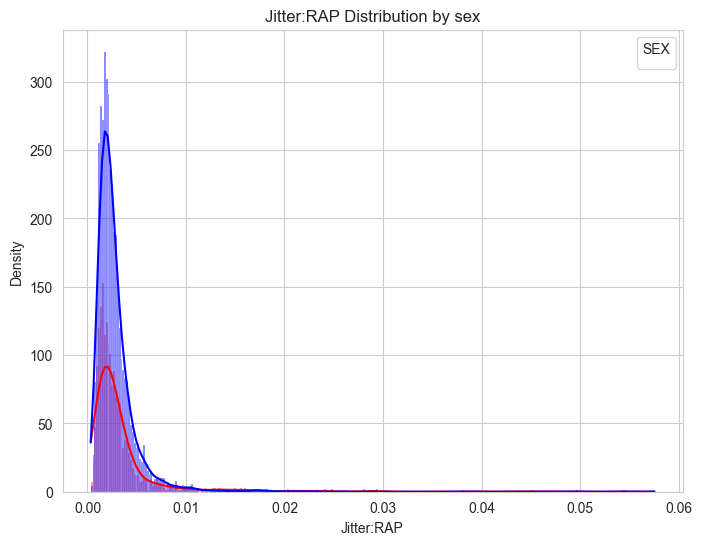

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


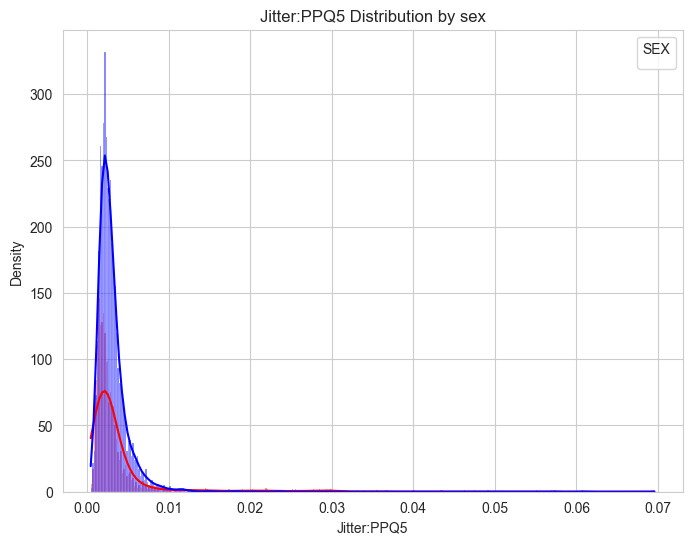

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


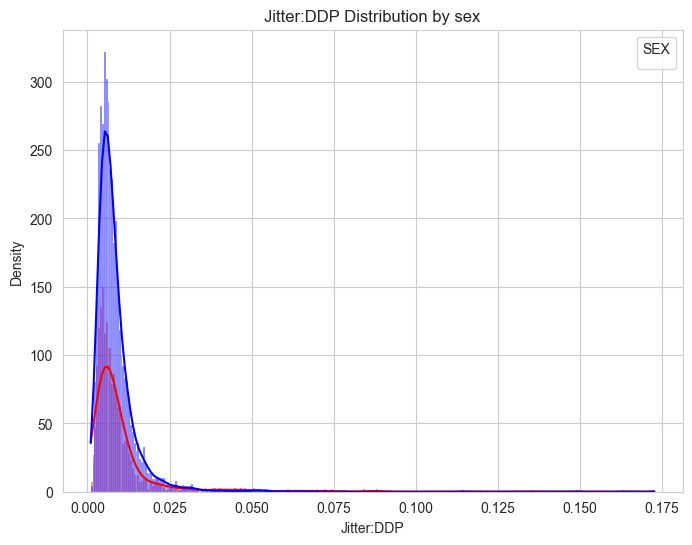

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


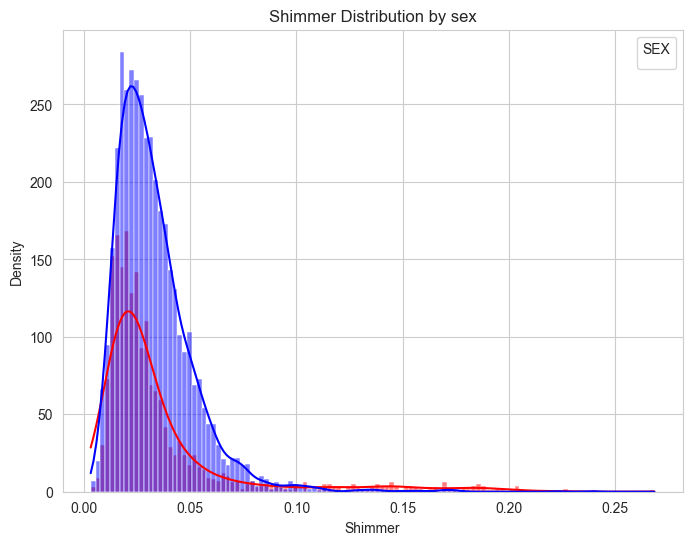

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


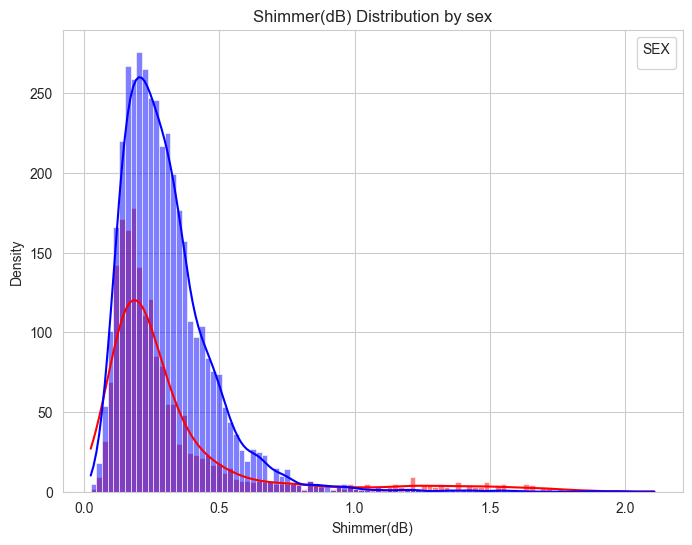

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


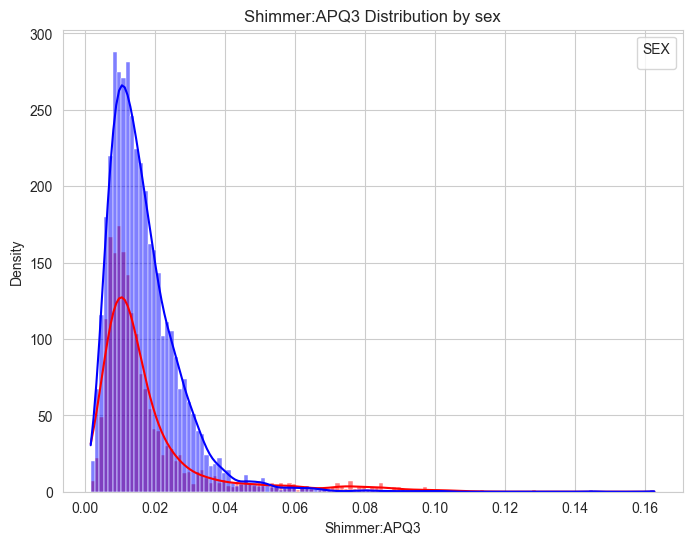

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


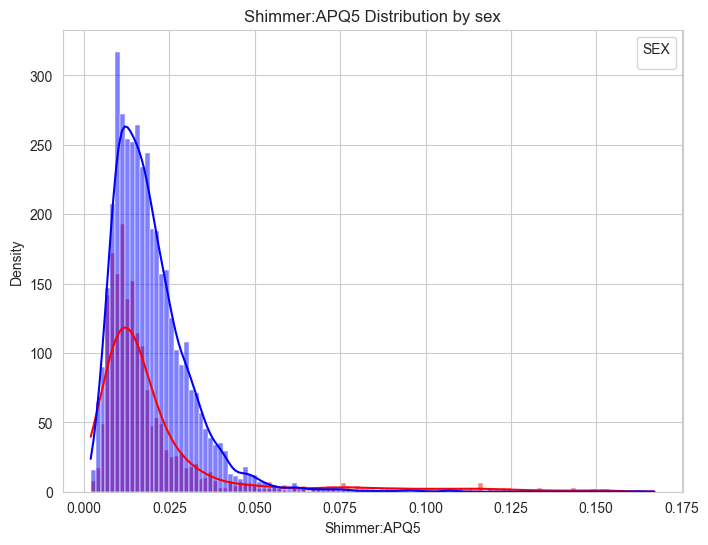

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


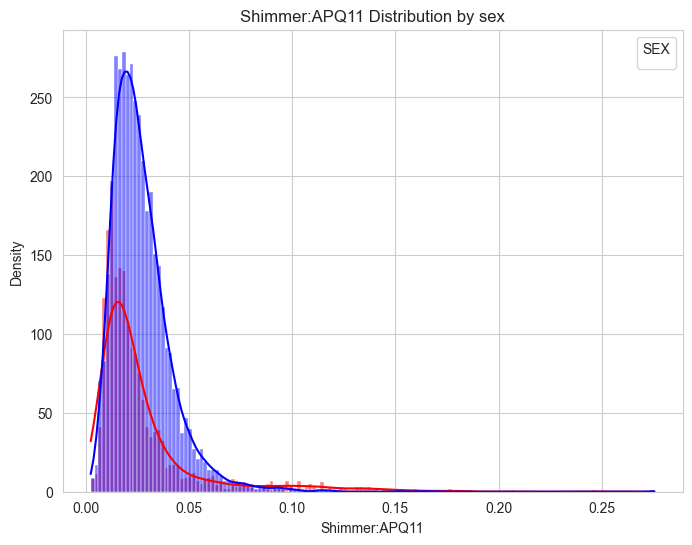

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


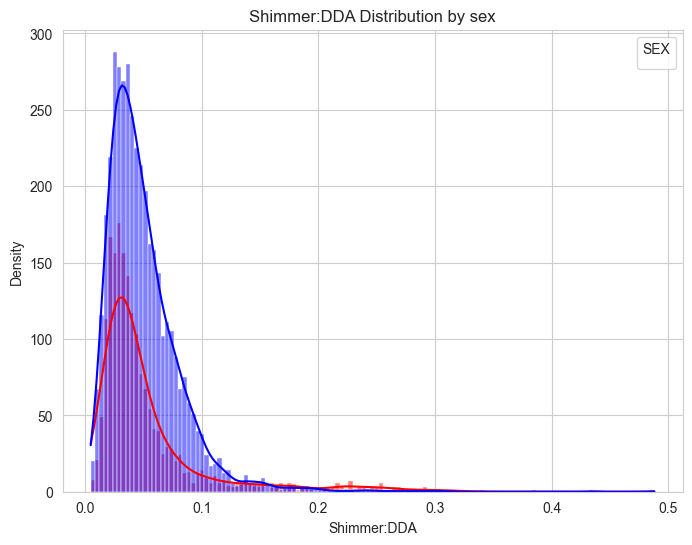

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


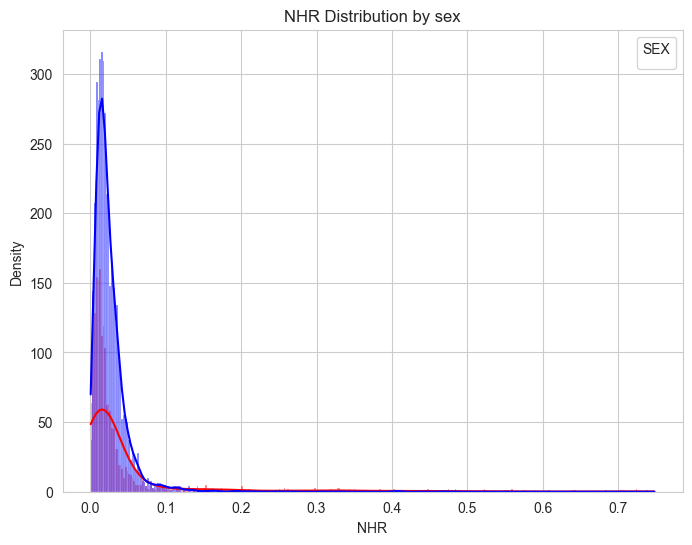

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


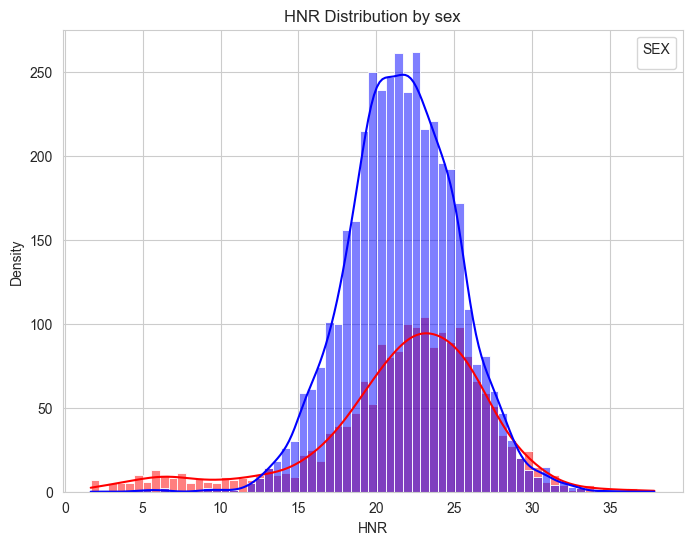

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


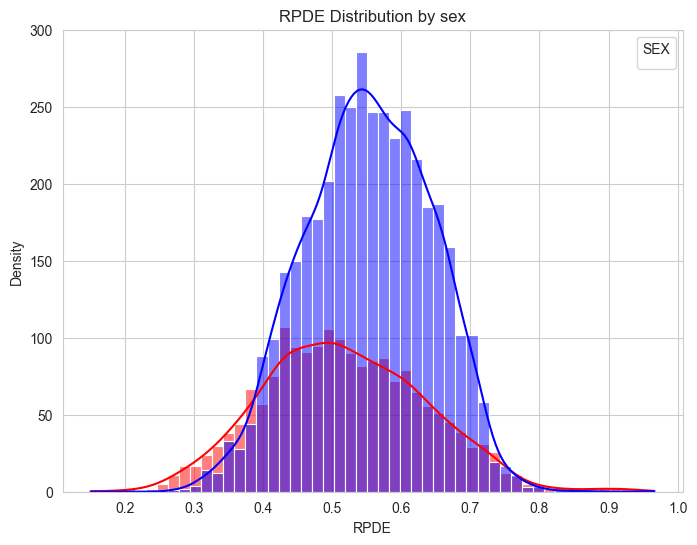

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


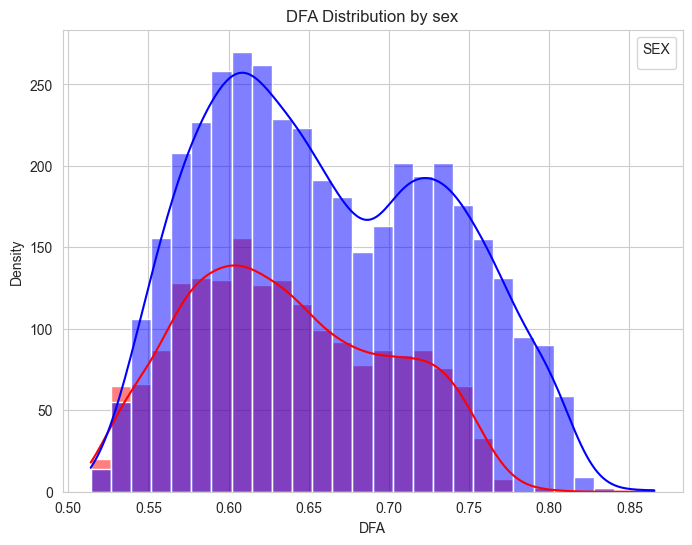

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


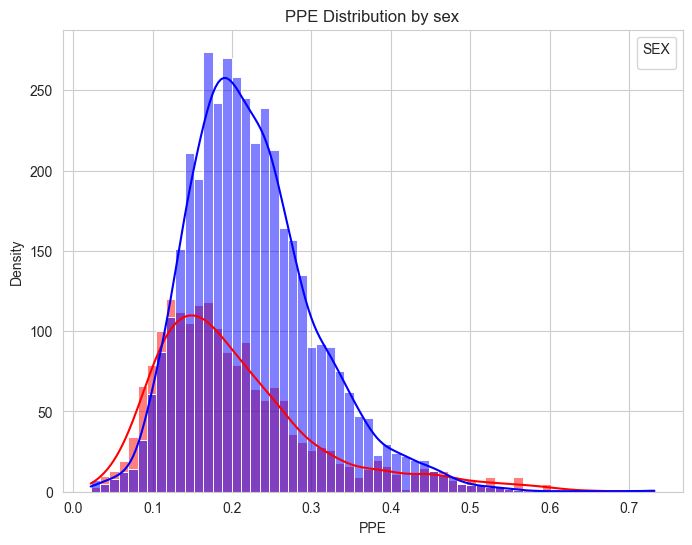

In [15]:
# Melakukan pengujian visual antara atribut dan label 'SEX'
for column in data_new.columns[:-1]:  # Mengabaikan kolom 'sEX' karena itu adalah label
    if data_new[column].dtype == 'int64' or data_new[column].dtype == 'float64':  # Jika atribut numerik
        plt.figure(figsize=(8, 6))
        sns.histplot(x=column, hue='sex', data=data_new, kde=True, palette={0: 'blue', 1: 'red'})
        plt.title(f'{column} Distribution by sex')
        plt.xlabel(column)
        plt.ylabel('Density')
        plt.legend(title='SEX', loc='upper right')
        plt.show()
    else:  # Jika atribut kategorikal
        plt.figure(figsize=(8, 6))
        sns.countplot(x=column, hue='sex', data=data_new, palette={0: 'blue', 1: 'red'})
        plt.title(f'{column} vs. SEX')
        plt.xlabel(column)
        plt.ylabel('Count')
        plt.legend(title='SEX', loc='upper right')
        plt.show()

# Menampilkan centroid jika dimensi data memungkinkan
if len(data_new.columns) == 2:  # Cek jika dimensi data adalah dua
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=data_new, x=data_new.columns[0], y=data_new.columns[1], hue='sex', palette={0: 'blue', 1: 'red'})
    plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='o', s=100, c='r', label='Centroid')
    plt.xlabel(data_new.columns[0])
    plt.ylabel(data_new.columns[1])
    plt.title('Scatter plot with Clusters and Centroids')
    plt.legend()
    plt.show()

# SilhoutteScore Data Tidak Berlabel K-Means

In [16]:
cluster_values=[2,3,4,5]
for k in cluster_values:
    kmeans=KMeans(n_clusters=k,random_state=42)
    kmeans.fit(df_data)
    silhouette_avg = silhouette_score(df_data,kmeans.labels_)
    print(f"Silhouette Score data tanpa label {k} cluster : {silhouette_avg}")

Silhouette Score data tanpa label 2 cluster : 0.7018267602457872
Silhouette Score data tanpa label 3 cluster : 0.2851545504374073
Silhouette Score data tanpa label 4 cluster : 0.2263325033302035
Silhouette Score data tanpa label 5 cluster : 0.17874024811495168


# SilhoutteScore Data Berlabel K-Means

In [17]:
cluster_values=[2,3,4,5]
for k in cluster_values:
    kmeans=KMeans(n_clusters=k,random_state=42)
    kmeans.fit(data_new)
    silhouette_avg = silhouette_score(data_new,kmeans.labels_)
    print(f"Silhouette Score data berlabel {k} cluster : {silhouette_avg}")

Silhouette Score data berlabel 2 cluster : 0.6002848885320586
Silhouette Score data berlabel 3 cluster : 0.5066679378224533
Silhouette Score data berlabel 4 cluster : 0.4645910493928265
Silhouette Score data berlabel 5 cluster : 0.4161638147954336


In [19]:
X = data_new.iloc[:,:17]
y = data_new.sex
# Bagi dataset menjadi data pelatihan dan data pengujian
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standarisasi fitur
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Definisikan daftar model yang akan digunakan
models = {
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Support Vector Machine": SVC()
}

target_names = ['Lak-Laki', 'Perempuan']

# Latih dan evaluasi model-model tersebut
for name, model in models.items():
    print("Training", name)
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)
    accuracy = accuracy_score(y_test, y_pred)
    print("Accuracy:", accuracy)
    report = classification_report(y_test, y_pred, target_names=target_names)
    print("Classification Report for", name)
    print(report)
    print()

Training K-Nearest Neighbors


Accuracy: 0.894468085106383
Classification Report for K-Nearest Neighbors
              precision    recall  f1-score   support

    Lak-Laki       0.90      0.95      0.92       791
   Perempuan       0.88      0.78      0.83       384

    accuracy                           0.89      1175
   macro avg       0.89      0.86      0.88      1175
weighted avg       0.89      0.89      0.89      1175


Training Decision Tree
Accuracy: 0.9429787234042554
Classification Report for Decision Tree
              precision    recall  f1-score   support

    Lak-Laki       0.95      0.96      0.96       791
   Perempuan       0.92      0.90      0.91       384

    accuracy                           0.94      1175
   macro avg       0.94      0.93      0.93      1175
weighted avg       0.94      0.94      0.94      1175


Training Random Forest
Accuracy: 0.9719148936170213
Classification Report for Random Forest
              precision    recall  f1-score   support

    Lak-Laki       0.97      0.